# **Import Packages**

In [ ]:
!pip install mediapipe
!pip install pillow
!pip install matplotlib
!pip install numpy
!pip install opencv-python
!pip install requests
!pip install tqdm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 36.1/36.1 MB 29.2 MB/s eta 0:00:00


In [ ]:
def show_image(img, figsize=(10, 10)):
    plt.figure(figsize=figsize)
    plt.imshow(img)
    plt.show()

# **Human Posture Encoding**

In [ ]:
class FullBodyPoseEmbedder(object):
  """Converts 3D pose landmarks into 3D embedding."""

  def __init__(self, torso_size_multiplier=2.5):
    # Multiplier to apply to the torso to get minimal body size.
    self._torso_size_multiplier = torso_size_multiplier

    # Names of the landmarks as they appear in the prediction.
    self._landmark_names = [
        'nose',
        'left_eye_inner', 'left_eye', 'left_eye_outer',
        'right_eye_inner', 'right_eye', 'right_eye_outer',
        'left_ear', 'right_ear',
        'mouth_left', 'mouth_right',
        'left_shoulder', 'right_shoulder',
        'left_elbow', 'right_elbow',
        'left_wrist', 'right_wrist',
        'left_pinky_1', 'right_pinky_1',
        'left_index_1', 'right_index_1',
        'left_thumb_2', 'right_thumb_2',
        'left_hip', 'right_hip',
        'left_knee', 'right_knee',
        'left_ankle', 'right_ankle',
        'left_heel', 'right_heel',
        'left_foot_index', 'right_foot_index',
    ]

  def __call__(self, landmarks):
    """Normalizes pose landmarks and converts to embedding

    Args:
      landmarks - NumPy array with 3D landmarks of shape (N, 3).

    Result:
      Numpy array with pose embedding of shape (M, 3) where `M` is the number of
      pairwise distances defined in `_get_pose_distance_embedding`.
    """
    assert landmarks.shape[0] == len(self._landmark_names), 'Unexpected number of landmarks: {}'.format(landmarks.shape[0])

    # Get pose landmarks.
    landmarks = np.copy(landmarks)

    # Normalize landmarks.
    landmarks = self._normalize_pose_landmarks(landmarks)

    # Get embedding.
    embedding = self._get_pose_distance_embedding(landmarks)

    return embedding

  def _normalize_pose_landmarks(self, landmarks):
    """Normalizes landmarks translation and scale."""
    landmarks = np.copy(landmarks)

    # Normalize translation.
    pose_center = self._get_pose_center(landmarks)
    landmarks -= pose_center

    # Normalize scale.
    pose_size = self._get_pose_size(landmarks, self._torso_size_multiplier)
    landmarks /= pose_size
    # Multiplication by 100 is not required, but makes it eaasier to debug.
    landmarks *= 100

    return landmarks

  def _get_pose_center(self, landmarks):
    """Calculates pose center as point between hips."""
    left_hip = landmarks[self._landmark_names.index('left_hip')]
    right_hip = landmarks[self._landmark_names.index('right_hip')]
    center = (left_hip + right_hip) * 0.5
    return center

  def _get_pose_size(self, landmarks, torso_size_multiplier):
    """Calculates pose size.

    It is the maximum of two values:
      * Torso size multiplied by `torso_size_multiplier`
      * Maximum distance from pose center to any pose landmark
    """
    # This approach uses only 2D landmarks to compute pose size.
    landmarks = landmarks[:, :2]

    # Hips center.
    left_hip = landmarks[self._landmark_names.index('left_hip')]
    right_hip = landmarks[self._landmark_names.index('right_hip')]
    hips = (left_hip + right_hip) * 0.5

    # Shoulders center.
    left_shoulder = landmarks[self._landmark_names.index('left_shoulder')]
    right_shoulder = landmarks[self._landmark_names.index('right_shoulder')]
    shoulders = (left_shoulder + right_shoulder) * 0.5

    # Torso size as the minimum body size.
    torso_size = np.linalg.norm(shoulders - hips)

    # Max dist to pose center.
    pose_center = self._get_pose_center(landmarks)
    max_dist = np.max(np.linalg.norm(landmarks - pose_center, axis=1))

    return max(torso_size * torso_size_multiplier, max_dist)

  def _get_pose_distance_embedding(self, landmarks):
    """Converts pose landmarks into 3D embedding.

    We use several pairwise 3D distances to form pose embedding. All distances
    include X and Y components with sign. We differnt types of pairs to cover
    different pose classes. Feel free to remove some or add new.

    Args:
      landmarks - NumPy array with 3D landmarks of shape (N, 3).

    Result:
      Numpy array with pose embedding of shape (M, 3) where `M` is the number of
      pairwise distances.
    """
    embedding = np.array([
        # One joint.

        self._get_distance(
            self._get_average_by_names(landmarks, 'left_hip', 'right_hip'),
            self._get_average_by_names(landmarks, 'left_shoulder', 'right_shoulder')),

        self._get_distance_by_names(landmarks, 'left_shoulder', 'left_elbow'),
        self._get_distance_by_names(landmarks, 'right_shoulder', 'right_elbow'),

        self._get_distance_by_names(landmarks, 'left_elbow', 'left_wrist'),
        self._get_distance_by_names(landmarks, 'right_elbow', 'right_wrist'),

        self._get_distance_by_names(landmarks, 'left_hip', 'left_knee'),
        self._get_distance_by_names(landmarks, 'right_hip', 'right_knee'),

        self._get_distance_by_names(landmarks, 'left_knee', 'left_ankle'),
        self._get_distance_by_names(landmarks, 'right_knee', 'right_ankle'),

        # Two joints.

        self._get_distance_by_names(landmarks, 'left_shoulder', 'left_wrist'),
        self._get_distance_by_names(landmarks, 'right_shoulder', 'right_wrist'),

        self._get_distance_by_names(landmarks, 'left_hip', 'left_ankle'),
        self._get_distance_by_names(landmarks, 'right_hip', 'right_ankle'),

        # Four joints.

        self._get_distance_by_names(landmarks, 'left_hip', 'left_wrist'),
        self._get_distance_by_names(landmarks, 'right_hip', 'right_wrist'),

        # Five joints.

        self._get_distance_by_names(landmarks, 'left_shoulder', 'left_ankle'),
        self._get_distance_by_names(landmarks, 'right_shoulder', 'right_ankle'),

        self._get_distance_by_names(landmarks, 'left_hip', 'left_wrist'),
        self._get_distance_by_names(landmarks, 'right_hip', 'right_wrist'),

        # Cross body.

        self._get_distance_by_names(landmarks, 'left_elbow', 'right_elbow'),
        self._get_distance_by_names(landmarks, 'left_knee', 'right_knee'),

        self._get_distance_by_names(landmarks, 'left_wrist', 'right_wrist'),
        self._get_distance_by_names(landmarks, 'left_ankle', 'right_ankle'),

        # Body bent direction.

        # self._get_distance(
        #     self._get_average_by_names(landmarks, 'left_wrist', 'left_ankle'),
        #     landmarks[self._landmark_names.index('left_hip')]),
        # self._get_distance(
        #     self._get_average_by_names(landmarks, 'right_wrist', 'right_ankle'),
        #     landmarks[self._landmark_names.index('right_hip')]),
    ])

    return embedding

  def _get_average_by_names(self, landmarks, name_from, name_to):
    lmk_from = landmarks[self._landmark_names.index(name_from)]
    lmk_to = landmarks[self._landmark_names.index(name_to)]
    return (lmk_from + lmk_to) * 0.5

  def _get_distance_by_names(self, landmarks, name_from, name_to):
    lmk_from = landmarks[self._landmark_names.index(name_from)]
    lmk_to = landmarks[self._landmark_names.index(name_to)]
    return self._get_distance(lmk_from, lmk_to)

  def _get_distance(self, lmk_from, lmk_to):
    return lmk_to - lmk_from

# **Human Posture Classification**

In [ ]:
class PoseSample(object):

  def __init__(self, name, landmarks, class_name, embedding):
    self.name = name
    self.landmarks = landmarks
    self.class_name = class_name

    self.embedding = embedding


class PoseSampleOutlier(object):

  def __init__(self, sample, detected_class, all_classes):
    self.sample = sample
    self.detected_class = detected_class
    self.all_classes = all_classes


In [ ]:
import csv
import numpy as np
import os

class PoseClassifier(object):

  def __init__(self,
               pose_samples_folder,
               pose_embedder,
               file_extension='csv',
               file_separator=',',
               n_landmarks=33,
               n_dimensions=3,
               top_n_by_max_distance=30,
               top_n_by_mean_distance=10,
               axes_weights=(1., 1., 0.2)):
    self._pose_embedder = pose_embedder
    self._n_landmarks = n_landmarks
    self._n_dimensions = n_dimensions
    self._top_n_by_max_distance = top_n_by_max_distance
    self._top_n_by_mean_distance = top_n_by_mean_distance
    self._axes_weights = axes_weights

    self._pose_samples = self._load_pose_samples(pose_samples_folder,
                                                 file_extension,
                                                 file_separator,
                                                 n_landmarks,
                                                 n_dimensions,
                                                 pose_embedder)

  def _load_pose_samples(self,
                         pose_samples_folder,
                         file_extension,
                         file_separator,
                         n_landmarks,
                         n_dimensions,
                         pose_embedder):

    # Each file in the folder represents one pose class.
    file_names = [name for name in os.listdir(pose_samples_folder) if name.endswith(file_extension)]

    pose_samples = []
    for file_name in file_names:
      # Use file name as pose class name.
      class_name = file_name[:-(len(file_extension) + 1)]

      # Parse CSV.
      with open(os.path.join(pose_samples_folder, file_name)) as csv_file:
        csv_reader = csv.reader(csv_file, delimiter=file_separator)
        for row in csv_reader:
          assert len(row) == n_landmarks * n_dimensions + 1, 'Wrong number of values: {}'.format(len(row))
          landmarks = np.array(row[1:], np.float32).reshape([n_landmarks, n_dimensions])
          pose_samples.append(PoseSample(
              name=row[0],
              landmarks=landmarks,
              class_name=class_name,
              embedding=pose_embedder(landmarks),
          ))

    return pose_samples

  def find_pose_sample_outliers(self):
    """Classifies each sample against the entire database."""
    # Find outliers in target poses
    outliers = []
    for sample in self._pose_samples:
      # Find nearest poses for the target one.
      pose_landmarks = sample.landmarks.copy()
      pose_classification = self.__call__(pose_landmarks)
      class_names = [class_name for class_name, count in pose_classification.items() if count == max(pose_classification.values())]

      # Sample is an outlier if nearest poses have different class or more than
      # one pose class is detected as nearest.
      if sample.class_name not in class_names or len(class_names) != 1:
        outliers.append(PoseSampleOutlier(sample, class_names, pose_classification))

    return outliers

  def __call__(self, pose_landmarks):
    # Check that provided and target poses have the same shape.
    assert pose_landmarks.shape == (self._n_landmarks, self._n_dimensions), 'Unexpected shape: {}'.format(pose_landmarks.shape)

    # Get given pose embedding.
    pose_embedding = self._pose_embedder(pose_landmarks)
    flipped_pose_embedding = self._pose_embedder(pose_landmarks * np.array([-1, 1, 1]))

    # Filter by max distance.
    #
    # That helps to remove outliers - poses that are almost the same as the
    # given one, but has one joint bent into another direction and actually
    # represnt a different pose class.
    max_dist_heap = []
    for sample_idx, sample in enumerate(self._pose_samples):
      max_dist = min(
          np.max(np.abs(sample.embedding - pose_embedding) * self._axes_weights),
          np.max(np.abs(sample.embedding - flipped_pose_embedding) * self._axes_weights),
      )
      max_dist_heap.append([max_dist, sample_idx])

    max_dist_heap = sorted(max_dist_heap, key=lambda x: x[0])
    max_dist_heap = max_dist_heap[:self._top_n_by_max_distance]

    # Filter by mean distance.
    #
    # After removing outliers we can find the nearest pose by mean distance.
    mean_dist_heap = []
    for _, sample_idx in max_dist_heap:
      sample = self._pose_samples[sample_idx]
      mean_dist = min(
          np.mean(np.abs(sample.embedding - pose_embedding) * self._axes_weights),
          np.mean(np.abs(sample.embedding - flipped_pose_embedding) * self._axes_weights),
      )
      mean_dist_heap.append([mean_dist, sample_idx])

    mean_dist_heap = sorted(mean_dist_heap, key=lambda x: x[0])
    mean_dist_heap = mean_dist_heap[:self._top_n_by_mean_distance]

    # Collect results into map: (class_name -> n_samples)
    class_names = [self._pose_samples[sample_idx].class_name for _, sample_idx in mean_dist_heap]
    result = {class_name: class_names.count(class_name) for class_name in set(class_names)}

    return result

# **Human Posture Classification Result Smoothing**

In [ ]:
class EMADictSmoothing(object):
  """Smoothes pose classification."""

  def __init__(self, window_size=10, alpha=0.2):
    self._window_size = window_size
    self._alpha = alpha

    self._data_in_window = []

  def __call__(self, data):
    # Add new data to the beginning of the window for simpler code.
    self._data_in_window.insert(0, data)
    self._data_in_window = self._data_in_window[:self._window_size]

    # Get all keys.
    keys = set([key for data in self._data_in_window for key, _ in data.items()])

    # Get smoothed values.
    smoothed_data = dict()
    for key in keys:
      factor = 1.0
      top_sum = 0.0
      bottom_sum = 0.0
      for data in self._data_in_window:
        value = data[key] if key in data else 0.0

        top_sum += factor * value
        bottom_sum += factor

        # Update factor.
        factor *= (1.0 - self._alpha)

      smoothed_data[key] = top_sum / bottom_sum

    return smoothed_data

# **Stroke Counter**

In [ ]:
class RepetitionCounter(object):

  def __init__(self, class_name, enter_threshold=9, exit_threshold=1):
    self._class_name = class_name

    # If pose counter passes given threshold, then we enter the pose.
    self._enter_threshold = enter_threshold
    self._exit_threshold = exit_threshold

    # Either we are in given pose or not.
    self._pose_entered = False

    # Number of times we exited the pose.
    self._n_repeats = 0

  @property
  def n_repeats(self):
    return self._n_repeats

  def __call__(self, pose_classification):
    # Get pose confidence.
    pose_confidence = 0.0
    if self._class_name in pose_classification:
      pose_confidence = pose_classification[self._class_name]

    # On the very first frame or if we were out of the pose, just check if we
    # entered it on this frame and update the state.
    if not self._pose_entered:
      self._pose_entered = pose_confidence > self._enter_threshold
      return self._n_repeats

    # If we were in the pose and are exiting it, then increase the counter and
    # update the state.
    if pose_confidence < self._exit_threshold:
      self._n_repeats += 1
      self._pose_entered = False

    return self._n_repeats

# **Visualization**

In [ ]:
import io
from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw
import requests

class PoseClassificationVisualizer(object):

  def __init__(self,
               class_name,
               plot_location_x=0.05,
               plot_location_y=0.05,
               plot_max_width=0.4,
               plot_max_height=0.4,
               plot_figsize=(9, 4),
               plot_x_max=None,
               plot_y_max=None,
               counter_location_x=0.85,
               counter_location_y=0.05,
               counter_font_path='https://github.com/googlefonts/roboto/blob/main/src/hinted/Roboto-Regular.ttf?raw=true',
               counter_font_color='red',
               counter_font_size=0.15):
    self._class_name = class_name
    self._plot_location_x = plot_location_x
    self._plot_location_y = plot_location_y
    self._plot_max_width = plot_max_width
    self._plot_max_height = plot_max_height
    self._plot_figsize = plot_figsize
    self._plot_x_max = plot_x_max
    self._plot_y_max = plot_y_max
    self._counter_location_x = counter_location_x
    self._counter_location_y = counter_location_y
    self._counter_font_path = counter_font_path
    self._counter_font_color = counter_font_color
    self._counter_font_size = counter_font_size

    self._counter_font = None

    self._pose_classification_history = []
    self._pose_classification_filtered_history = []

  def __call__(self,
               frame,
               pose_classification,
               pose_classification_filtered,
               repetitions_count):
    # Extend classification history.
    self._pose_classification_history.append(pose_classification)
    self._pose_classification_filtered_history.append(pose_classification_filtered)

    # Output frame with classification plot and counter.
    output_img = Image.fromarray(frame)

    output_width = output_img.size[0]
    output_height = output_img.size[1]

    # Draw the plot.
    img = self._plot_classification_history(output_width, output_height)
    img.thumbnail((int(output_width * self._plot_max_width),
                   int(output_height * self._plot_max_height)),
                  Image.Resampling.LANCZOS)
    output_img.paste(img,
                     (int(output_width * self._plot_location_x),
                      int(output_height * self._plot_location_y)))

    # Draw the count.
    output_img_draw = ImageDraw.Draw(output_img)
    if self._counter_font is None:
      font_size = int(output_height * self._counter_font_size)
      font_request = requests.get(self._counter_font_path, allow_redirects=True)
      self._counter_font = ImageFont.truetype(io.BytesIO(font_request.content), size=font_size)
    output_img_draw.text((output_width * self._counter_location_x,
                          output_height * self._counter_location_y),
                         str(repetitions_count),
                         font=self._counter_font,
                         fill=self._counter_font_color)

    return output_img

  def _plot_classification_history(self, output_width, output_height):
    fig = plt.figure(figsize=self._plot_figsize)

    for classification_history in [self._pose_classification_history,
                                   self._pose_classification_filtered_history]:
      y = []
      for classification in classification_history:
        if classification is None:
          y.append(None)
        elif self._class_name in classification:
          y.append(classification[self._class_name])
        else:
          y.append(0)
      plt.plot(y, linewidth=7)

    plt.grid(axis='y', alpha=0.75)
    plt.xlabel('Frame')
    plt.ylabel('Confidence')
    plt.title('Classification history for `{}`'.format(self._class_name))
    plt.legend(loc='upper right')

    if self._plot_y_max is not None:
      plt.ylim(top=self._plot_y_max)
    if self._plot_x_max is not None:
      plt.xlim(right=self._plot_x_max)

    # Convert plot to image.
    buf = io.BytesIO()
    dpi = min(
        output_width * self._plot_max_width / float(self._plot_figsize[0]),
        output_height * self._plot_max_height / float(self._plot_figsize[1]))
    fig.savefig(buf, dpi=dpi)
    buf.seek(0)
    img = Image.open(buf)
    plt.close()

    return img

# **Extraction of key point coordinates of training set**

In [ ]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
import os
from PIL import Image
import sys
import tqdm

from mediapipe.python.solutions import drawing_utils as mp_drawing
from mediapipe.python.solutions import pose as mp_pose


class BootstrapHelper(object):

  def __init__(self,
               images_in_folder,
               images_out_folder,
               csvs_out_folder):
    self._images_in_folder = images_in_folder
    self._images_out_folder = images_out_folder
    self._csvs_out_folder = csvs_out_folder

    # Get list of pose classes and print image statistics.
    self._pose_class_names = sorted([n for n in os.listdir(self._images_in_folder) if not n.startswith('.')])

  def bootstrap(self, per_pose_class_limit=None):
    # Create output folder for CVSs.
    if not os.path.exists(self._csvs_out_folder):
      os.makedirs(self._csvs_out_folder)

    for pose_class_name in self._pose_class_names:
      print('Bootstrapping ', pose_class_name, file=sys.stderr)

      # Paths for the pose class.
      images_in_folder = os.path.join(self._images_in_folder, pose_class_name)
      images_out_folder = os.path.join(self._images_out_folder, pose_class_name)
      csv_out_path = os.path.join(self._csvs_out_folder, pose_class_name + '.csv')
      if not os.path.exists(images_out_folder):
        os.makedirs(images_out_folder)

      with open(csv_out_path, 'w') as csv_out_file:
        csv_out_writer = csv.writer(csv_out_file, delimiter=',', quoting=csv.QUOTE_MINIMAL)
        # Get list of images.
        image_names = sorted([n for n in os.listdir(images_in_folder) if not n.startswith('.')])
        if per_pose_class_limit is not None:
          image_names = image_names[:per_pose_class_limit]

        # Bootstrap every image.
        for image_name in tqdm.tqdm(image_names):
          # Load image.
          input_frame = cv2.imread(os.path.join(images_in_folder, image_name))
          input_frame = cv2.cvtColor(input_frame, cv2.COLOR_BGR2RGB)

          # Initialize fresh pose tracker and run it.
          with mp_pose.Pose() as pose_tracker:
            result = pose_tracker.process(image=input_frame)
            pose_landmarks = result.pose_landmarks

          # Save image with pose prediction (if pose was detected).
          output_frame = input_frame.copy()
          if pose_landmarks is not None:
            mp_drawing.draw_landmarks(
                image=output_frame,
                landmark_list=pose_landmarks,
                connections=mp_pose.POSE_CONNECTIONS)
          output_frame = cv2.cvtColor(output_frame, cv2.COLOR_RGB2BGR)
          cv2.imwrite(os.path.join(images_out_folder, image_name), output_frame)

          # Save landmarks if pose was detected.
          if pose_landmarks is not None:
            # Get landmarks.
            frame_height, frame_width = output_frame.shape[0], output_frame.shape[1]
            pose_landmarks = np.array(
                [[lmk.x * frame_width, lmk.y * frame_height, lmk.z * frame_width]
                 for lmk in pose_landmarks.landmark],
                dtype=np.float32)
            assert pose_landmarks.shape == (33, 3), 'Unexpected landmarks shape: {}'.format(pose_landmarks.shape)
            csv_out_writer.writerow([image_name] + pose_landmarks.flatten().astype(str).tolist())

          # Draw XZ projection and concatenate with the image.
          projection_xz = self._draw_xz_projection(
              output_frame=output_frame, pose_landmarks=pose_landmarks)
          output_frame = np.concatenate((output_frame, projection_xz), axis=1)

  def _draw_xz_projection(self, output_frame, pose_landmarks, r=0.5, color='red'):
    frame_height, frame_width = output_frame.shape[0], output_frame.shape[1]
    img = Image.new('RGB', (frame_width, frame_height), color='white')

    if pose_landmarks is None:
      return np.asarray(img)

    # Scale radius according to the image width.
    r *= frame_width * 0.01

    draw = ImageDraw.Draw(img)
    for idx_1, idx_2 in mp_pose.POSE_CONNECTIONS:
      # Flip Z and move hips center to the center of the image.
      x1, y1, z1 = pose_landmarks[idx_1] * [1, 1, -1] + [0, 0, frame_height * 0.5]
      x2, y2, z2 = pose_landmarks[idx_2] * [1, 1, -1] + [0, 0, frame_height * 0.5]

      draw.ellipse([x1 - r, z1 - r, x1 + r, z1 + r], fill=color)
      draw.ellipse([x2 - r, z2 - r, x2 + r, z2 + r], fill=color)
      draw.line([x1, z1, x2, z2], width=int(r), fill=color)

    return np.asarray(img)

  def align_images_and_csvs(self, print_removed_items=False):
    for pose_class_name in self._pose_class_names:
      # Paths for the pose class.
      images_out_folder = os.path.join(self._images_out_folder, pose_class_name)
      csv_out_path = os.path.join(self._csvs_out_folder, pose_class_name + '.csv')

      # Read CSV into memory.
      rows = []
      with open(csv_out_path) as csv_out_file:
        csv_out_reader = csv.reader(csv_out_file, delimiter=',')
        for row in csv_out_reader:
          rows.append(row)

      # Image names left in CSV.
      image_names_in_csv = []

      # Re-write the CSV removing lines without corresponding images.
      with open(csv_out_path, 'w') as csv_out_file:
        csv_out_writer = csv.writer(csv_out_file, delimiter=',', quoting=csv.QUOTE_MINIMAL)
        for row in rows:
          image_name = row[0]
          image_path = os.path.join(images_out_folder, image_name)
          if os.path.exists(image_path):
            image_names_in_csv.append(image_name)
            csv_out_writer.writerow(row)
          elif print_removed_items:
            print('Removed image from CSV: ', image_path)

      # Remove images without corresponding line in CSV.
      for image_name in os.listdir(images_out_folder):
        if image_name not in image_names_in_csv:
          image_path = os.path.join(images_out_folder, image_name)
          os.remove(image_path)
          if print_removed_items:
            print('Removed image from folder: ', image_path)

  def analyze_outliers(self, outliers):
    for outlier in outliers:
      image_path = os.path.join(self._images_out_folder, outlier.sample.class_name, outlier.sample.name)

      print('Outlier')
      print('  sample path =    ', image_path)
      print('  sample class =   ', outlier.sample.class_name)
      print('  detected class = ', outlier.detected_class)
      print('  all classes =    ', outlier.all_classes)

      img = cv2.imread(image_path)
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      show_image(img, figsize=(20, 20))

  def remove_outliers(self, outliers):
    """Removes outliers from the image folders."""
    for outlier in outliers:
      image_path = os.path.join(self._images_out_folder, outlier.sample.class_name, outlier.sample.name)
      os.remove(image_path)

  def print_images_in_statistics(self):
    """Prints statistics from the input image folder."""
    self._print_images_statistics(self._images_in_folder, self._pose_class_names)

  def print_images_out_statistics(self):
    """Prints statistics from the output image folder."""
    self._print_images_statistics(self._images_out_folder, self._pose_class_names)

  def _print_images_statistics(self, images_folder, pose_class_names):
    print('Number of images per pose class:')
    for pose_class_name in pose_class_names:
      n_images = len([
          n for n in os.listdir(os.path.join(images_folder, pose_class_name))
          if not n.startswith('.')])
      print('  {}: {}'.format(pose_class_name, n_images))

# **Classifier Construction**

In [ ]:
from google.colab import drive
from google.colab import files
drive.mount('/content/drive', force_remount = True)

Mounted at /content/drive


In [ ]:
import os
os.listdir('./')

['Video1A.mp4',
 'Video1H.mp4',
 'Video2A.mp4',
 'Video2H.mp4',
 '.DS_Store',
 'rowing_csvs_out',
 'rowing_images_out',
 'Video1H-output.mp4',
 'Video1A-output.mp4',
 'rowing_dataset',
 'Video3A.mp4',
 'Video3F.mp4',
 'Video4A.mp4',
 'Video4F.mp4',
 'Video4A_values.csv',
 'Video4F_values.csv',
 'Video4A-output.mp4',
 'Video4F-output.mp4',
 'rowing_csvs_out_basic.csv',
 'Video3F_values.csv',
 'Video3F-output.mp4']

In [ ]:
os.chdir('./drive/MyDrive/RowingDATA/')

In [ ]:
bootstrap_images_in_folder = 'rowing_dataset'
bootstrap_images_out_folder = 'rowing_images_out'
bootstrap_csvs_out_folder = 'rowing_csvs_out'

In [ ]:
bootstrap_helper = BootstrapHelper(
    images_in_folder=bootstrap_images_in_folder,
    images_out_folder=bootstrap_images_out_folder,
    csvs_out_folder=bootstrap_csvs_out_folder,
)

In [ ]:
bootstrap_helper.print_images_in_statistics()

Number of images per pose class:
  down: 34
  up: 40


In [ ]:
bootstrap_helper.bootstrap(per_pose_class_limit=None)

Bootstrapping  down
100%|██████████| 34/34 [00:58<00:00,  1.71s/it]
Bootstrapping  up
100%|██████████| 40/40 [01:11<00:00,  1.79s/it]


# **Classifier Debugging**

In [ ]:
bootstrap_helper.align_images_and_csvs(print_removed_items=False)
bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  down: 34
  up: 40


In [ ]:
# Visualization of Error
pose_embedder = FullBodyPoseEmbedder()

pose_classifier = PoseClassifier(
    pose_samples_folder=bootstrap_csvs_out_folder,
    pose_embedder=pose_embedder,
    top_n_by_max_distance=30,
    top_n_by_mean_distance=10)

outliers = pose_classifier.find_pose_sample_outliers()
print('Number of outliers: ', len(outliers))

Number of outliers:  3


Outlier
  sample path =     rowing_images_out/down/IMG_4918.jpg
  sample class =    down
  detected class =  ['up']
  all classes =     {'down': 2, 'up': 8}


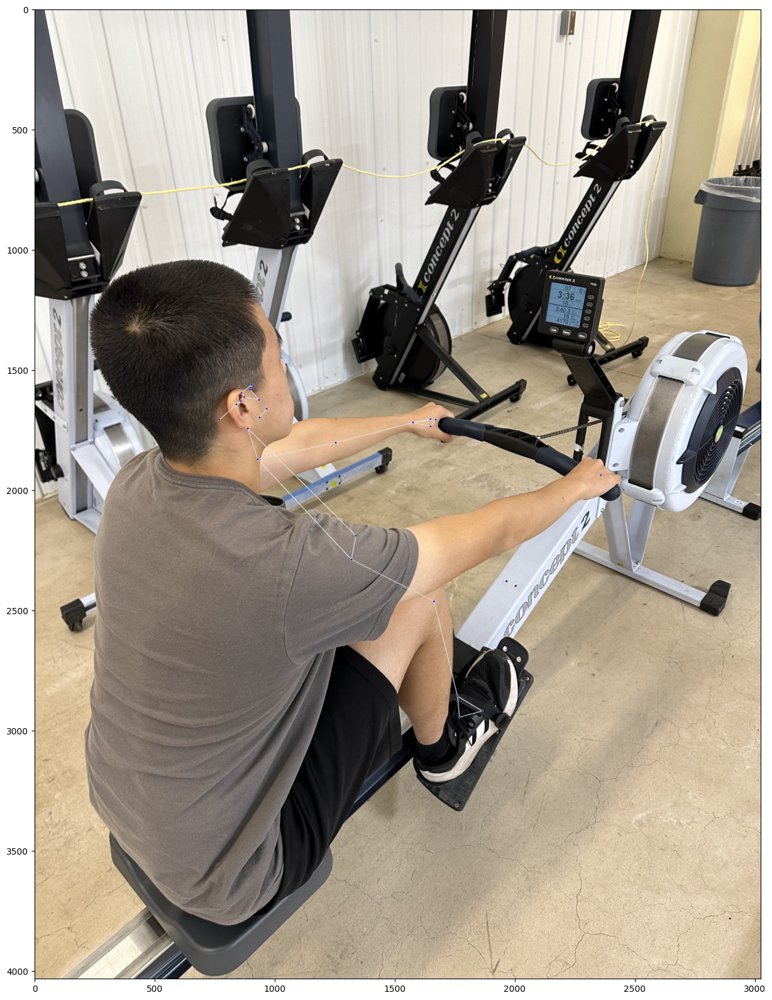

Outlier
  sample path =     rowing_images_out/up/IMG_4935.jpg
  sample class =    up
  detected class =  ['down']
  all classes =     {'down': 8, 'up': 2}


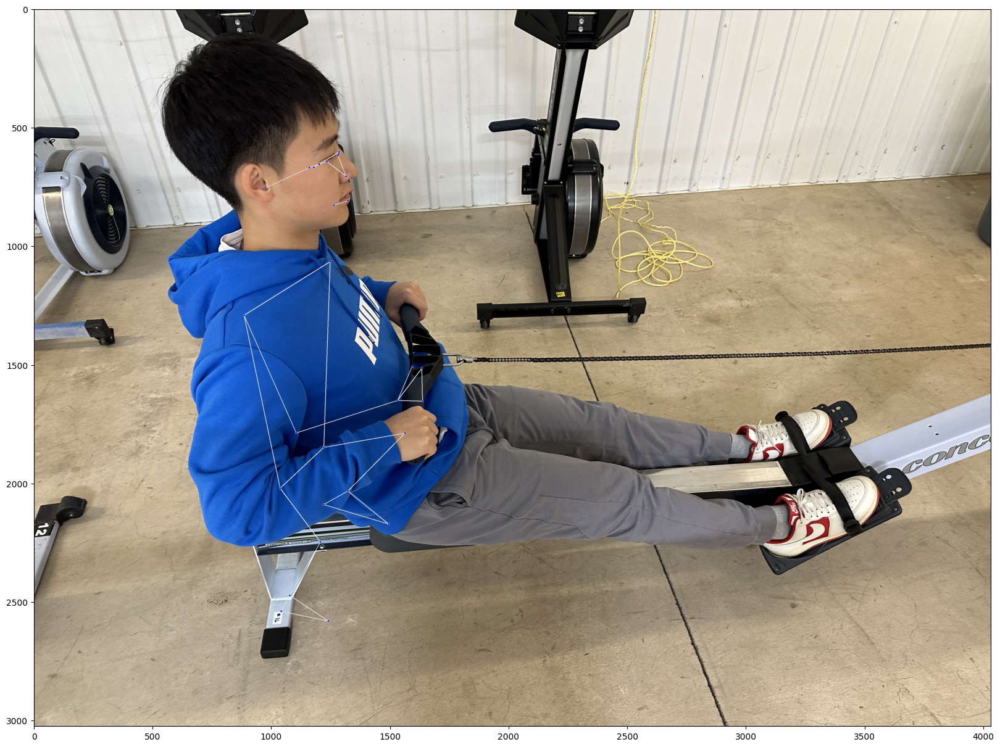

Outlier
  sample path =     rowing_images_out/up/IMG_4938.jpg
  sample class =    up
  detected class =  ['down']
  all classes =     {'down': 6, 'up': 4}


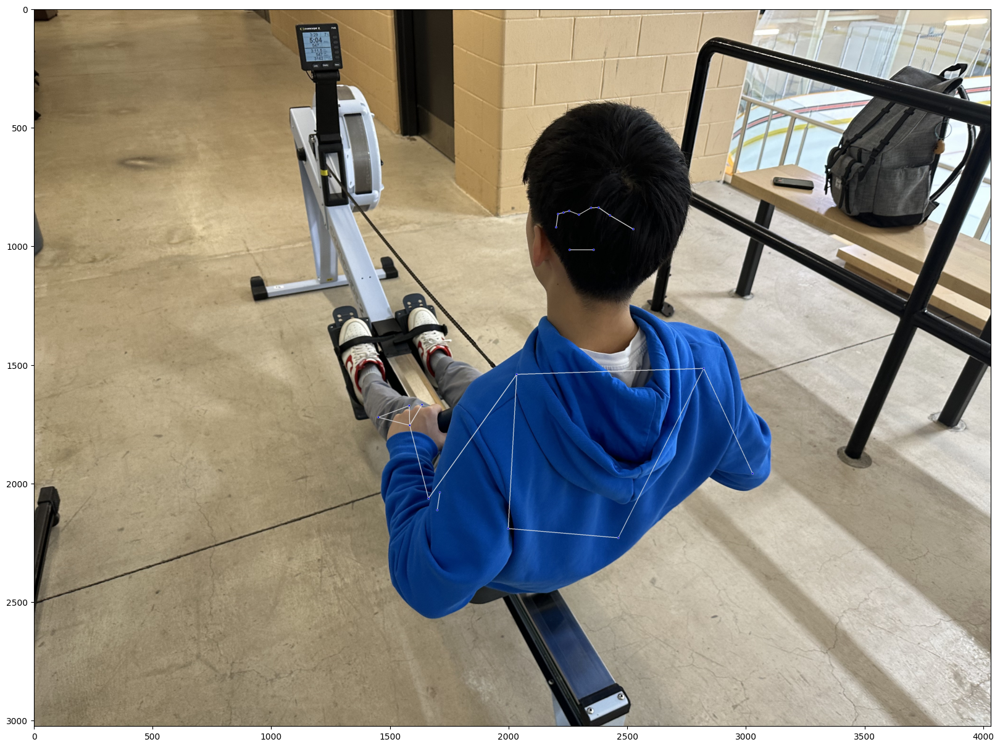

In [ ]:
bootstrap_helper.analyze_outliers(outliers)

In [ ]:
bootstrap_helper.align_images_and_csvs(print_removed_items=False)
bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  down: 34
  up: 40


# **CSV File Generation**

In [ ]:
import csv
import os
import numpy as np


def dump_for_the_app():
  pose_samples_folder = 'rowing_csvs_out'
  pose_samples_csv_path = 'rowing_csvs_out_basic.csv'
  file_extension = 'csv'
  file_separator = ','

  # Each file in the folder represents one pose class.
  file_names = [name for name in os.listdir(pose_samples_folder) if name.endswith(file_extension)]

  with open(pose_samples_csv_path, 'w') as csv_out:
    csv_out_writer = csv.writer(csv_out, delimiter=file_separator, quoting=csv.QUOTE_MINIMAL)
    for file_name in file_names:
      # Use file name as pose class name.
      class_name = file_name[:-(len(file_extension) + 1)]

      # One file line: `sample_00001,x1,y1,x2,y2,....`.
      with open(os.path.join(pose_samples_folder, file_name)) as csv_in:
        csv_in_reader = csv.reader(csv_in, delimiter=file_separator)
        for row in csv_in_reader:
          row.insert(1, class_name)
          csv_out_writer.writerow(row)

  files.download(pose_samples_csv_path)


dump_for_the_app()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# **Video Prediction**

In [ ]:
video_path = 'Video3A.mp4'
class_name='down'
out_video_path = 'Video3A-output.mp4'

In [ ]:
import cv2

video_cap = cv2.VideoCapture(video_path)

# Get some video parameters to generate output video with classificaiton.
video_n_frames = video_cap.get(cv2.CAP_PROP_FRAME_COUNT)
video_fps = video_cap.get(cv2.CAP_PROP_FPS)
video_width = int(video_cap.get(cv2.CAP_PROP_FRAME_WIDTH))
video_height = int(video_cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

In [ ]:
# Initilize tracker, classifier and counter.
# Do that before every video as all of them have state.
from mediapipe.python.solutions import pose as mp_pose


# Folder with pose class CSVs. That should be the same folder you using while
# building classifier to output CSVs.
pose_samples_folder = 'rowing_csvs_out'

# Initialize tracker.
pose_tracker = mp_pose.Pose()

# Initialize embedder.
pose_embedder = FullBodyPoseEmbedder()

# Initialize classifier.
# Ceck that you are using the same parameters as during bootstrapping.
pose_classifier = PoseClassifier(
    pose_samples_folder=pose_samples_folder,
    pose_embedder=pose_embedder,
    top_n_by_max_distance=30,
    top_n_by_mean_distance=10)

# # Uncomment to validate target poses used by classifier and find outliers.
# outliers = pose_classifier.find_pose_sample_outliers()
# print('Number of pose sample outliers (consider removing them): ', len(outliers))

# Initialize EMA smoothing.
pose_classification_filter = EMADictSmoothing(
    window_size=10,
    alpha=0.2)

repetition_counter = RepetitionCounter(
    class_name=class_name,
    enter_threshold=6,
    exit_threshold=4)

# Initialize renderer.
pose_classification_visualizer = PoseClassificationVisualizer(
    class_name=class_name,
    plot_x_max=video_n_frames,
    # Graphic looks nicer if it's the same as `top_n_by_mean_distance`.
    plot_y_max=10)

  0%|          | 0/961.0 [00:00<?, ?it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


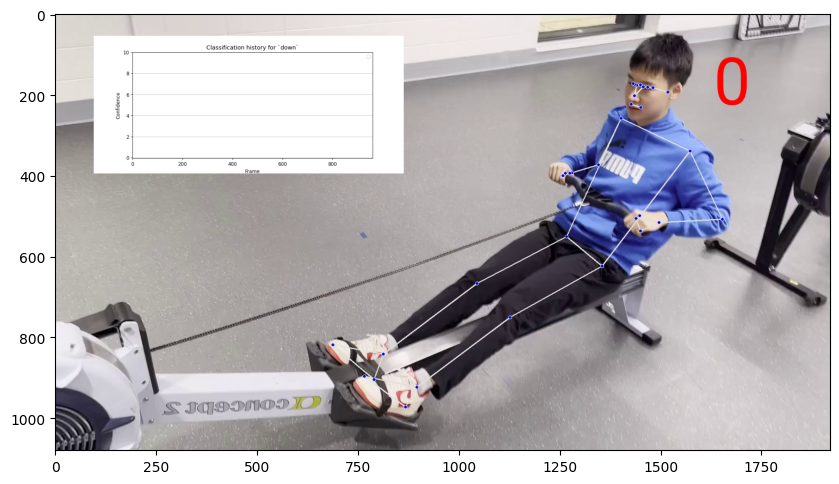

  0%|          | 1/961.0 [00:01<26:43,  1.67s/it]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  0%|          | 2/961.0 [00:01<13:39,  1.17it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  0%|          | 3/961.0 [00:02<09:12,  1.73it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  0%|          | 4/961.0 [00:02<07:09,  2.23it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  1%|          | 5/961.0 [00:02<05:56,  2.68it/s]WARNING:matplotlib.lege

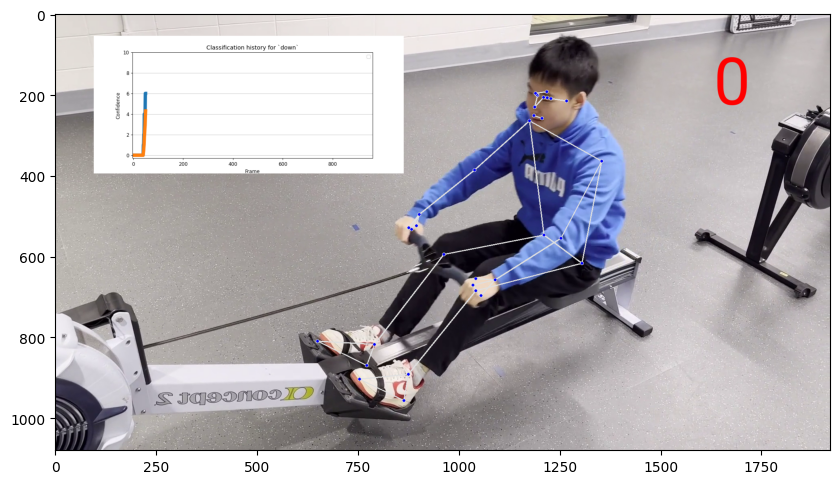

  5%|▌         | 51/961.0 [00:16<06:33,  2.31it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  5%|▌         | 52/961.0 [00:16<06:00,  2.52it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  6%|▌         | 53/961.0 [00:16<05:18,  2.85it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  6%|▌         | 54/961.0 [00:17<04:47,  3.16it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  6%|▌         | 55/961.0 [00:17<04:28,  3.37it/s]WARNING:matplotlib

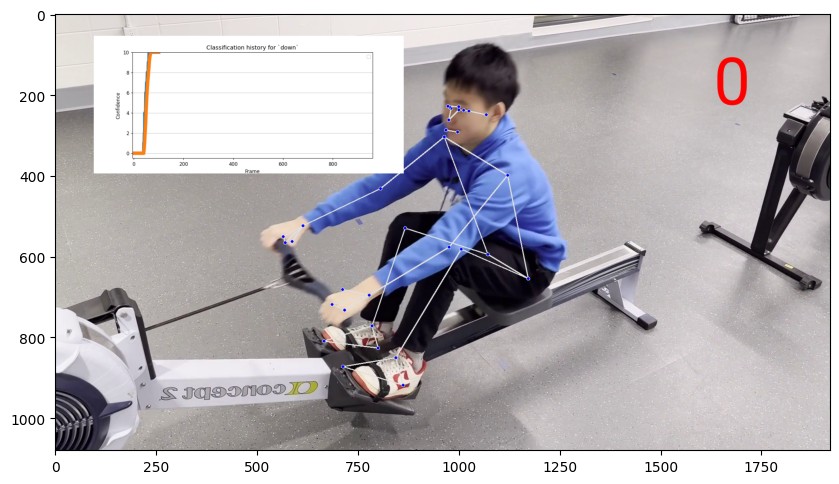

 11%|█         | 101/961.0 [00:31<06:23,  2.24it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 11%|█         | 102/961.0 [00:31<05:48,  2.47it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 11%|█         | 103/961.0 [00:32<05:03,  2.83it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 11%|█         | 104/961.0 [00:32<04:34,  3.12it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 11%|█         | 105/961.0 [00:32<04:18,  3.31it/s]WARNING:matpl

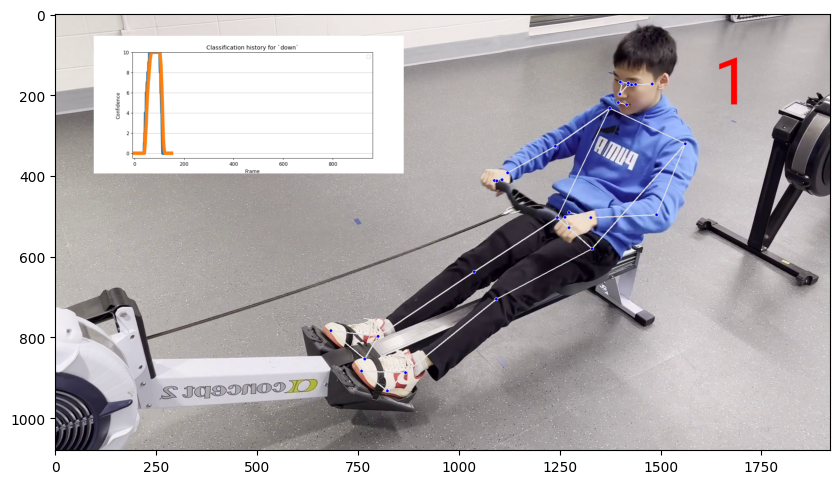

 16%|█▌        | 151/961.0 [00:46<05:55,  2.28it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 16%|█▌        | 152/961.0 [00:47<05:30,  2.45it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 16%|█▌        | 153/961.0 [00:47<04:56,  2.73it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 16%|█▌        | 154/961.0 [00:47<04:28,  3.00it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 16%|█▌        | 155/961.0 [00:47<04:12,  3.20it/s]WARNING:matpl

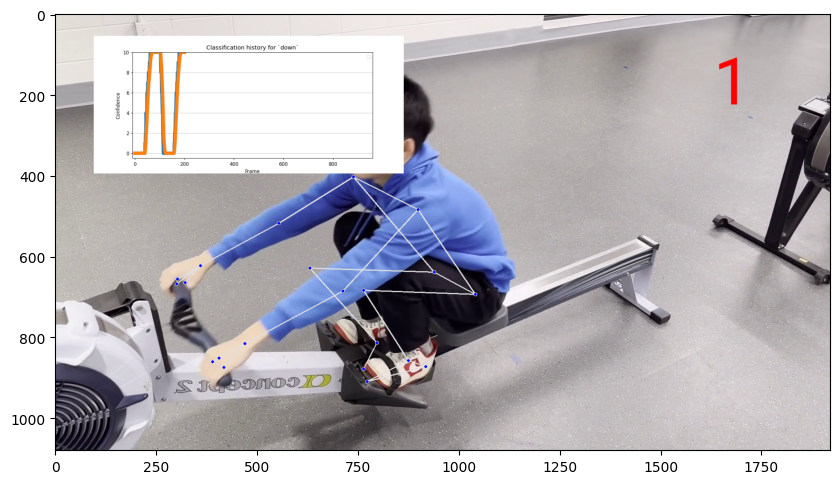

 21%|██        | 201/961.0 [01:02<05:43,  2.21it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 21%|██        | 202/961.0 [01:02<05:18,  2.38it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 21%|██        | 203/961.0 [01:03<04:40,  2.70it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 21%|██        | 204/961.0 [01:03<04:12,  3.00it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 21%|██▏       | 205/961.0 [01:03<03:59,  3.16it/s]WARNING:matpl

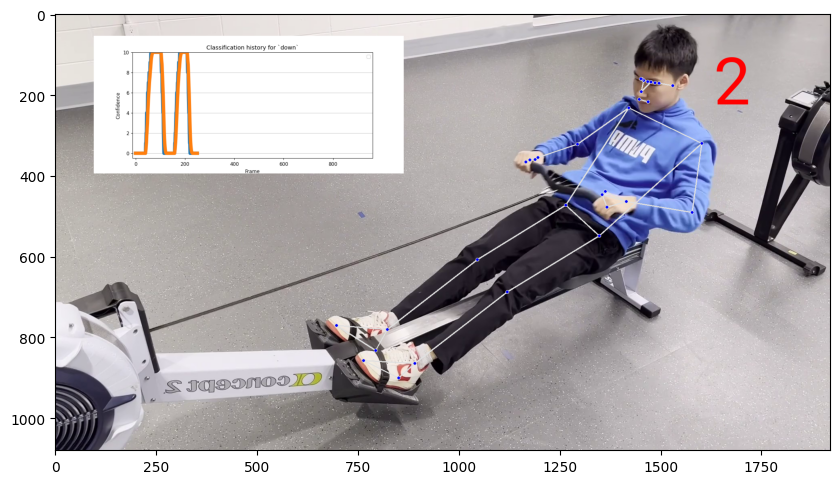

 26%|██▌       | 251/961.0 [01:18<05:21,  2.21it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 26%|██▌       | 252/961.0 [01:19<04:56,  2.39it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 26%|██▋       | 253/961.0 [01:19<04:27,  2.64it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 26%|██▋       | 254/961.0 [01:19<04:04,  2.89it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 27%|██▋       | 255/961.0 [01:19<03:50,  3.07it/s]WARNING:matpl

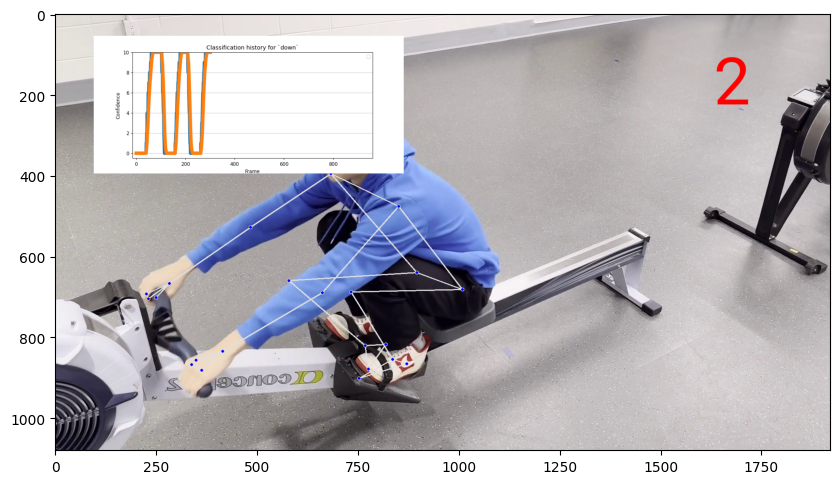

 31%|███▏      | 301/961.0 [01:35<05:03,  2.18it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 31%|███▏      | 302/961.0 [01:36<06:04,  1.81it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 32%|███▏      | 303/961.0 [01:36<05:11,  2.12it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 32%|███▏      | 304/961.0 [01:36<04:28,  2.45it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 32%|███▏      | 305/961.0 [01:36<04:05,  2.68it/s]WARNING:matpl

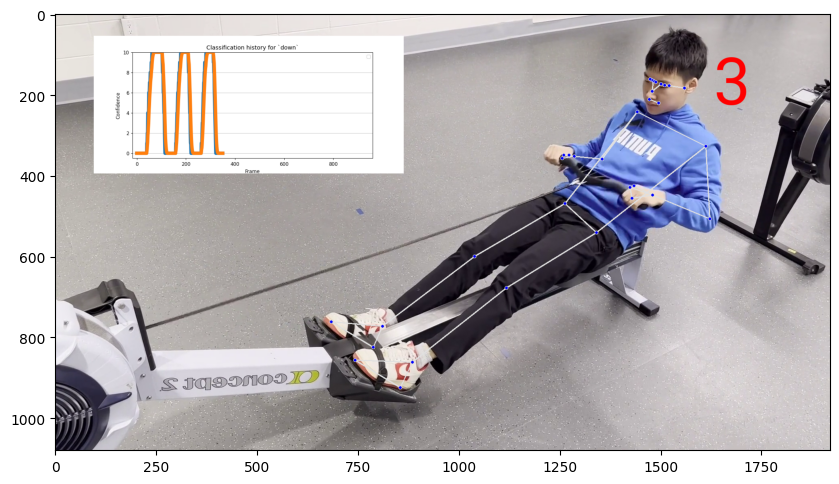

 37%|███▋      | 351/961.0 [01:52<04:40,  2.18it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 37%|███▋      | 352/961.0 [01:52<04:12,  2.41it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 37%|███▋      | 353/961.0 [01:53<03:57,  2.56it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 37%|███▋      | 354/961.0 [01:53<03:39,  2.76it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 37%|███▋      | 355/961.0 [01:53<03:25,  2.94it/s]WARNING:matpl

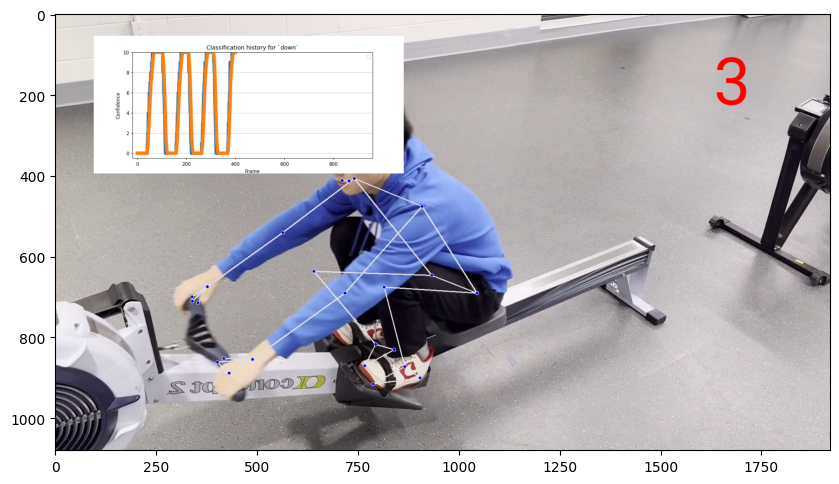

 42%|████▏     | 401/961.0 [02:09<04:25,  2.11it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 42%|████▏     | 402/961.0 [02:09<03:59,  2.33it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 42%|████▏     | 403/961.0 [02:10<03:42,  2.50it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 42%|████▏     | 404/961.0 [02:10<03:26,  2.70it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 42%|████▏     | 405/961.0 [02:10<03:12,  2.89it/s]WARNING:matpl

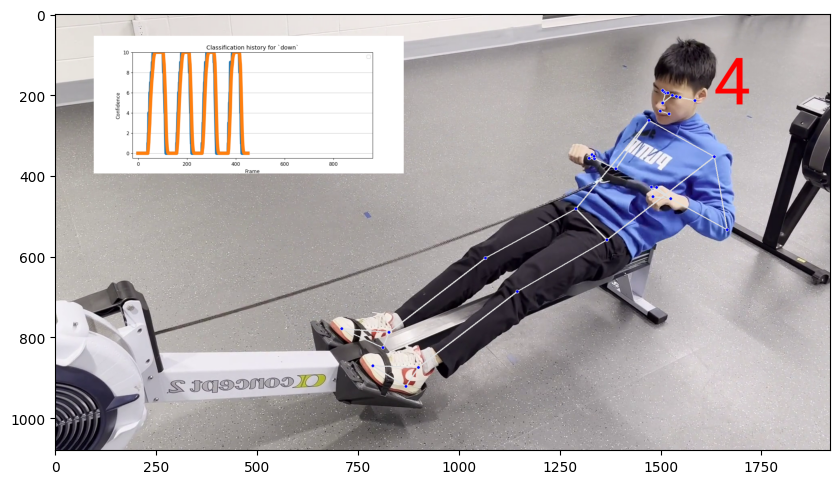

 47%|████▋     | 451/961.0 [02:27<03:58,  2.14it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 47%|████▋     | 452/961.0 [02:27<03:40,  2.31it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 47%|████▋     | 453/961.0 [02:27<03:24,  2.48it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 47%|████▋     | 454/961.0 [02:28<03:08,  2.68it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 47%|████▋     | 455/961.0 [02:28<02:59,  2.82it/s]WARNING:matpl

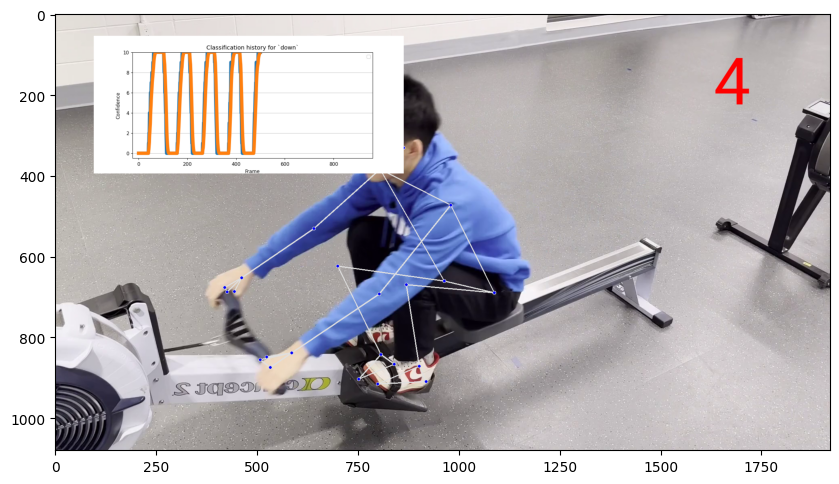

 52%|█████▏    | 501/961.0 [02:45<03:37,  2.11it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 52%|█████▏    | 502/961.0 [02:45<03:20,  2.29it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 52%|█████▏    | 503/961.0 [02:45<03:03,  2.49it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 52%|█████▏    | 504/961.0 [02:46<02:53,  2.64it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 53%|█████▎    | 505/961.0 [02:46<02:45,  2.76it/s]WARNING:matpl

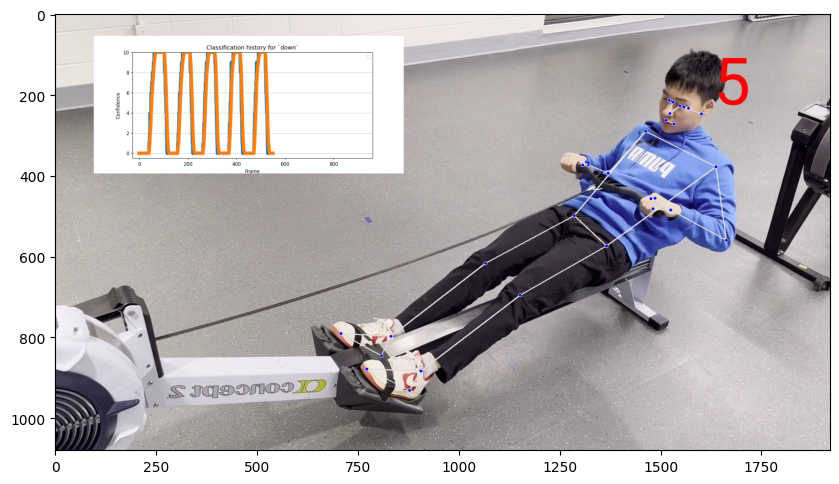

 57%|█████▋    | 551/961.0 [03:03<03:29,  1.96it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 57%|█████▋    | 552/961.0 [03:04<03:05,  2.21it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 58%|█████▊    | 553/961.0 [03:04<02:52,  2.36it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 58%|█████▊    | 554/961.0 [03:04<02:41,  2.51it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 58%|█████▊    | 555/961.0 [03:05<02:30,  2.71it/s]WARNING:matpl

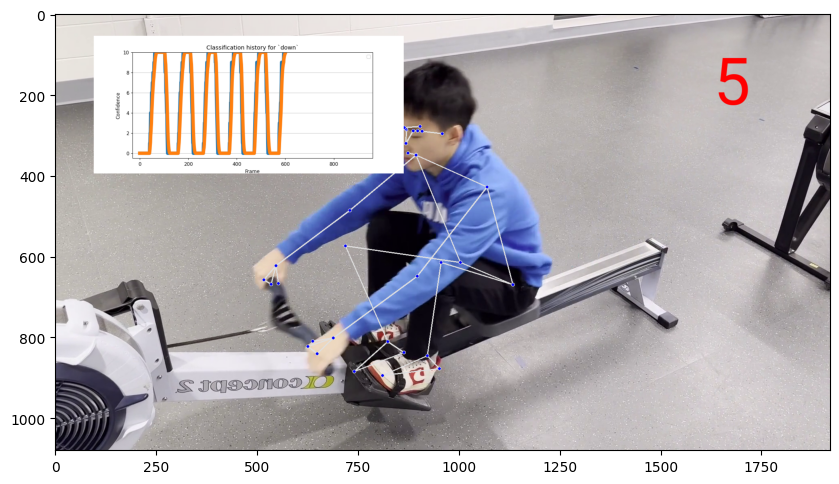

 63%|██████▎   | 601/961.0 [03:22<02:59,  2.01it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 63%|██████▎   | 602/961.0 [03:22<02:40,  2.24it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 63%|██████▎   | 603/961.0 [03:23<02:30,  2.38it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 63%|██████▎   | 604/961.0 [03:23<02:22,  2.50it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 63%|██████▎   | 605/961.0 [03:24<02:23,  2.49it/s]WARNING:matpl

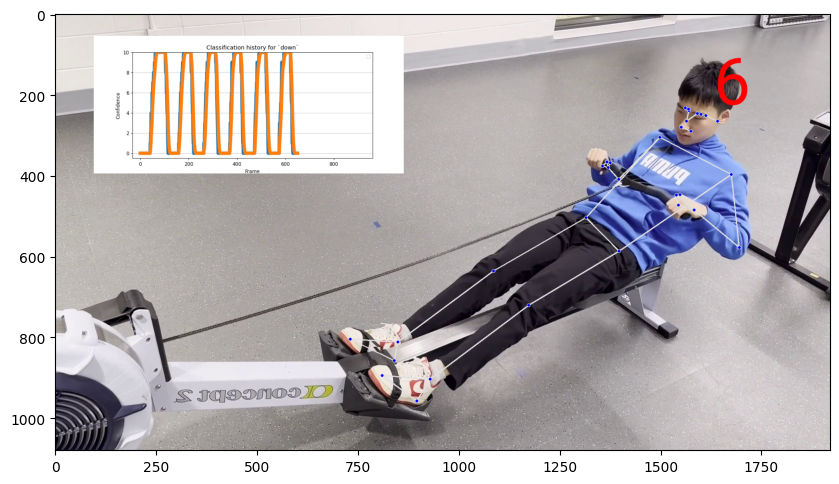

 68%|██████▊   | 651/961.0 [03:41<02:37,  1.97it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 68%|██████▊   | 652/961.0 [03:42<02:24,  2.14it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 68%|██████▊   | 653/961.0 [03:42<02:18,  2.22it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 68%|██████▊   | 654/961.0 [03:43<02:15,  2.27it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 68%|██████▊   | 655/961.0 [03:43<02:10,  2.35it/s]WARNING:matpl

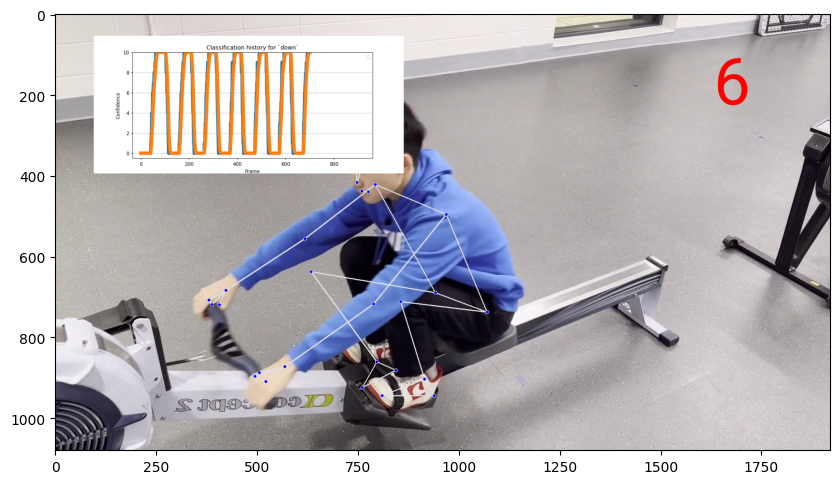

 73%|███████▎  | 701/961.0 [04:01<02:43,  1.59it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 73%|███████▎  | 702/961.0 [04:02<02:21,  1.84it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 73%|███████▎  | 703/961.0 [04:02<02:05,  2.05it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 73%|███████▎  | 704/961.0 [04:02<01:53,  2.25it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 73%|███████▎  | 705/961.0 [04:03<01:48,  2.36it/s]WARNING:matpl

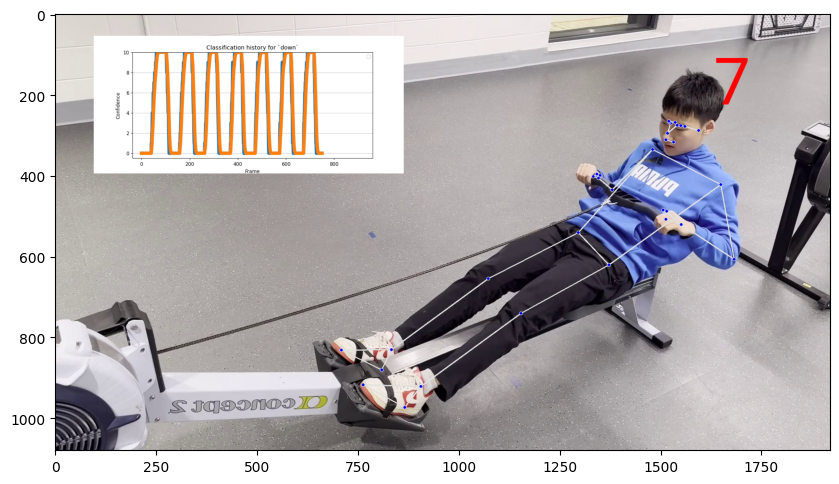

 78%|███████▊  | 751/961.0 [04:21<02:28,  1.42it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 78%|███████▊  | 752/961.0 [04:21<02:09,  1.61it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 78%|███████▊  | 753/961.0 [04:22<01:59,  1.75it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 78%|███████▊  | 754/961.0 [04:22<01:48,  1.91it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 79%|███████▊  | 755/961.0 [04:23<01:38,  2.10it/s]WARNING:matpl

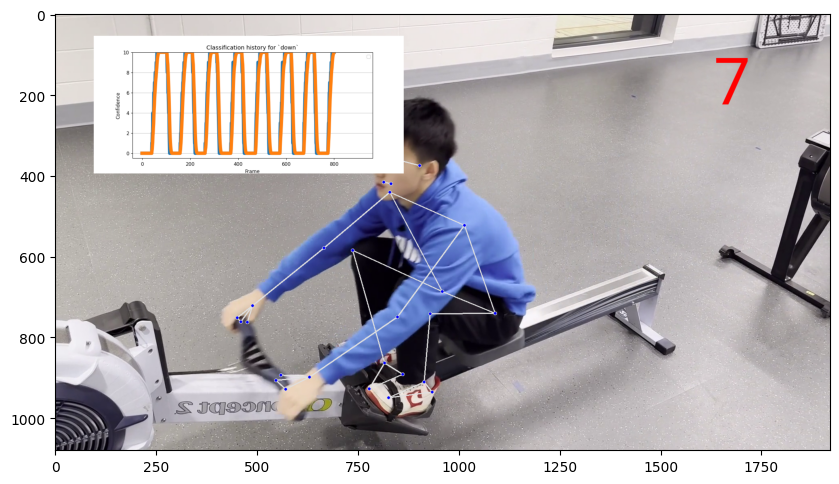

 83%|████████▎ | 801/961.0 [04:42<01:52,  1.42it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 83%|████████▎ | 802/961.0 [04:42<01:39,  1.60it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 84%|████████▎ | 803/961.0 [04:43<01:59,  1.32it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 84%|████████▎ | 804/961.0 [04:43<01:41,  1.55it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 84%|████████▍ | 805/961.0 [04:44<01:28,  1.76it/s]WARNING:matpl

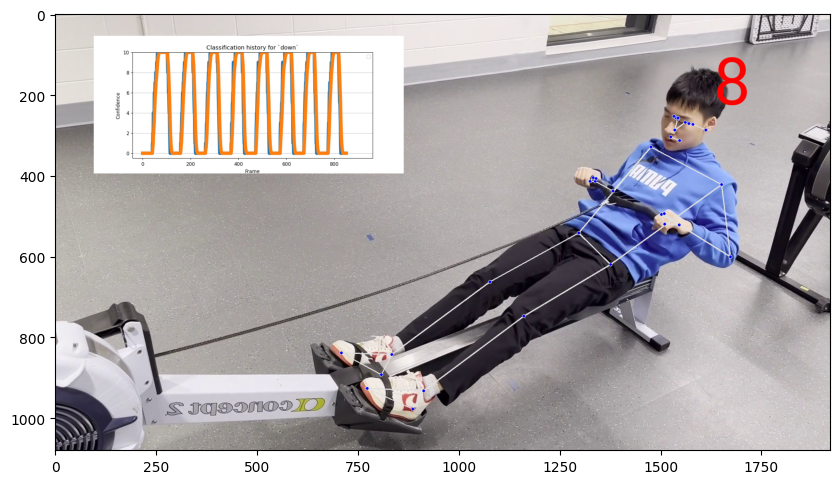

 89%|████████▊ | 851/961.0 [05:02<01:17,  1.42it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 89%|████████▊ | 852/961.0 [05:02<01:09,  1.58it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 89%|████████▉ | 853/961.0 [05:03<01:02,  1.72it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 89%|████████▉ | 854/961.0 [05:03<00:57,  1.86it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 89%|████████▉ | 855/961.0 [05:03<00:49,  2.14it/s]WARNING:matpl

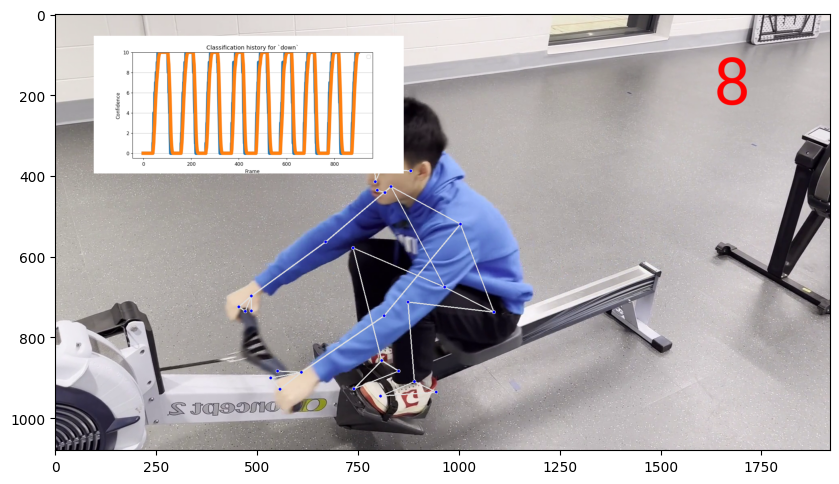

 94%|█████████▍| 901/961.0 [05:22<00:43,  1.38it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 94%|█████████▍| 902/961.0 [05:22<00:36,  1.62it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 94%|█████████▍| 903/961.0 [05:23<00:31,  1.85it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 94%|█████████▍| 904/961.0 [05:23<00:27,  2.06it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 94%|█████████▍| 905/961.0 [05:23<00:25,  2.24it/s]WARNING:matpl

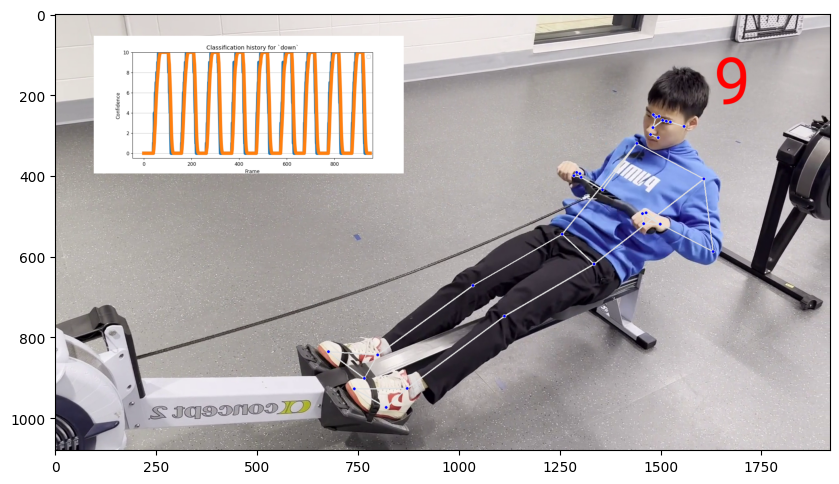

 99%|█████████▉| 951/961.0 [05:44<00:06,  1.47it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 99%|█████████▉| 952/961.0 [05:45<00:05,  1.70it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 99%|█████████▉| 953/961.0 [05:45<00:04,  1.95it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 99%|█████████▉| 954/961.0 [05:45<00:03,  2.20it/s]WARNING:matplotlib.legend:No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
 99%|█████████▉| 955/961.0 [05:46<00:02,  2.48it/s]WARNING:matpl

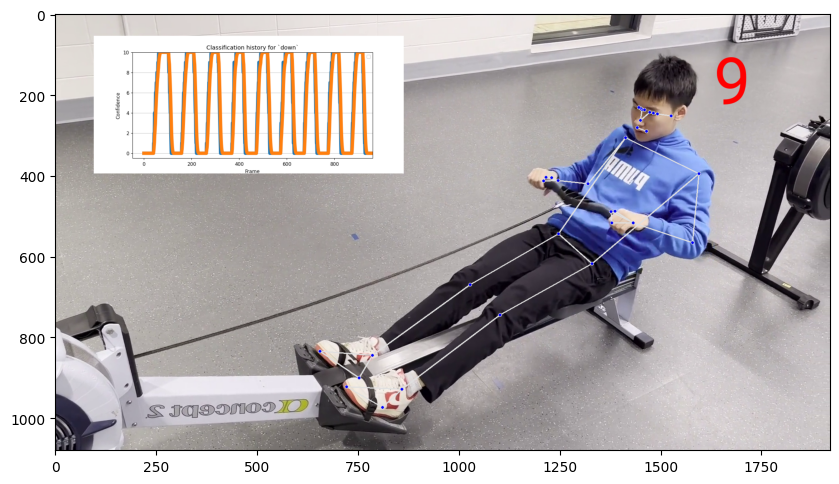

EMA values saved to Video3A_values.csv


In [ ]:
import csv  # Import CSV module to handle file writing
import os  # Ensure os is imported for file path manipulation

# Dynamically generate the CSV file name based on the video file name
video_name = os.path.splitext(os.path.basename(video_path))[0]  # Extract the video file name without extension
ema_csv_path = f"{video_name}_values.csv"

frame_idx = 0
output_frame = None

out_video = cv2.VideoWriter(out_video_path, cv2.VideoWriter_fourcc(*'mp4v'), video_fps, (video_width, video_height))

# Open CSV file for writing EMA values
with open(ema_csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    # Write header
    csv_writer.writerow(['Frame', 'EMA_Values'])

    with tqdm.tqdm(total=video_n_frames, position=0, leave=True) as pbar:
        while True:
            # Get next frame of the video.
            success, input_frame = video_cap.read()
            if not success:
                break

            # Run pose tracker.
            input_frame = cv2.cvtColor(input_frame, cv2.COLOR_BGR2RGB)
            result = pose_tracker.process(image=input_frame)
            pose_landmarks = result.pose_landmarks

            # Draw pose prediction.
            output_frame = input_frame.copy()
            if pose_landmarks is not None:
                mp_drawing.draw_landmarks(
                    image=output_frame,
                    landmark_list=pose_landmarks,
                    connections=mp_pose.POSE_CONNECTIONS)

            if pose_landmarks is not None:
                # Get landmarks.
                frame_height, frame_width = output_frame.shape[0], output_frame.shape[1]
                pose_landmarks = np.array([[lmk.x * frame_width, lmk.y * frame_height, lmk.z * frame_width]
                                           for lmk in pose_landmarks.landmark], dtype=np.float32)
                assert pose_landmarks.shape == (33, 3), 'Unexpected landmarks shape: {}'.format(pose_landmarks.shape)

                # Classify the pose on the current frame.
                pose_classification = pose_classifier(pose_landmarks)

                # Smooth classification using EMA.
                pose_classification_filtered = pose_classification_filter(pose_classification)

                # Extract EMA values and store them
                down_value = pose_classification_filtered.get('down', 0)  # Default to 0 if 'up' is not present
                csv_writer.writerow([frame_idx, down_value])  # Write frame and "up" value to CSV

                # Count repetitions.
                repetitions_count = repetition_counter(pose_classification_filtered)
            else:
                # No pose => no classification on current frame.
                pose_classification = None

                # Still add empty classification to the filter to maintain correct
                # smoothing for future frames.
                pose_classification_filtered = pose_classification_filter(dict())
                pose_classification_filtered = None

                # Don't update the counter presuming that person is 'frozen'. Just
                # take the latest repetitions count.
                repetitions_count = repetition_counter.n_repeats

            # Draw classification plot and repetition counter.
            output_frame = pose_classification_visualizer(
                frame=output_frame,
                pose_classification=pose_classification,
                pose_classification_filtered=pose_classification_filtered,
                repetitions_count=repetitions_count)

            # Save the output frame.
            out_video.write(cv2.cvtColor(np.array(output_frame), cv2.COLOR_RGB2BGR))

            # Show intermediate frames of the video to track progress.
            if frame_idx % 50 == 0:
                show_image(output_frame)

            frame_idx += 1
            pbar.update()

# Close output video.
out_video.release()

# Release MediaPipe resources.
try:
    if pose_tracker:
        pose_tracker.close()
except ValueError:
    print("pose_tracker was already closed.")

# Show the last frame of the video.
if output_frame is not None:
    show_image(output_frame)

print(f"EMA values saved to {ema_csv_path}")


In [ ]:
files.download(out_video_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
files.download(ema_csv_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  down: 34
  up: 40


In [ ]:
bootstrap_helper.align_images_and_csvs(print_removed_items=False)
bootstrap_helper.print_images_out_statistics()

Number of images per pose class:
  down: 34
  up: 40
